In [39]:
%pylab inline

from TB.c import *
import warnings
warnings.fi
rcParams['figure.facecolor'] = 'w'
rcParams['figure.dpi'] = 300

NAME = '200611-sw__metabolomics_noTh_predict_conc_no-intercept'

Populating the interactive namespace from numpy and matplotlib


In [2]:
mint_results_pos = 'output/200529-sw__process-metabolomics-MINT-results-Pos.csv'
mint_results_neg = 'output/200529-sw__process-metabolomics-MINT-results-Neg.csv'

In [3]:
def read_worklists():
    worklists = 'input/200529-rg__LSARP-Metabolomics-Full-Worklist.csv'
    worklists = pd.read_csv(worklists, header=1)
    worklists['ms_file'] =  worklists['File Name'] + '.mzXML'
    worklists = worklists[['ms_file', 'Position']]
    worklists['CHANNEL'] = worklists.Position.apply(lambda x: x.split(':')[0])
    worklists['WELL_ROW'] = worklists.Position.apply(lambda x: x.split(':')[1][0])
    worklists['WELL_COL'] = worklists.Position.apply(lambda x: x.split(':')[1][1:]).astype(int)
    del worklists['Position']
    return worklists

worklists = read_worklists()
worklists

,ms_file,CHANNEL,WELL_ROW,WELL_COL
0,2020_04_20RG_HILICPos15S_Col001_LSARP_SA008_Bl...,G,C,11
1,2020_04_20RG_HILICNeg15S_Col002_LSARP_SA008_Bl...,G,C,11
2,2020_04_20RG_HILICPos15S_Col001_LSARP_SA008_Bl...,G,C,11
3,2020_04_20RG_HILICNeg15S_Col002_LSARP_SA008_Bl...,G,C,11
4,2020_04_20RG_HILICPos15S_Col001_LSARP_SA008_Bl...,G,C,11
...,...,...,...,...
3421,2020_05_16RG_HILICNeg15S_Col002_MSMLS65.mzXML,B,B,2
3422,2020_05_16RG_HILICPos15S_Col001_Blank_post6.mzXML,B,F,9
3423,2020_05_16RG_HILICNeg15S_Col002_Blank_post6.mzXML,B,F,9
3424,2020_05_16RG_HILICPos15S_Col001_Blank_post7.mzXML,B,F,9


In [4]:
from os.path import basename
from datetime import datetime
import re

def extract_metadata_metabolomics(filename):
    base = basename(filename)
    patterns = dict(Col='Col[0-9]*',
                    PLATE='LSARP_SA([0-9]*)',
                    BI_NBR='BI_[0-9][0-9]_[0-9][0-9][0-9][0-9]',
                    DATE='[0-9][0-9][0-9][0-9]_[0-9][0-9]_[0-9][0-9]',
                    TAG='[A-Za-z0-9-]*.mzXML',
                    RPT='RPT[0-9]*')
    results = {}
    for name, pattern in patterns.items():
        try:
            results[name] = re.search(pattern, base)[0]
        except:
            results[name] = None
    if results['BI_NBR'] is not None:
        results['TAG'] = None
    else:
        results['TAG'] = results['TAG'].replace('.mzXML', '')
    if results['PLATE'] is not None:
        results['PLATE'] = results['PLATE'].replace('LSARP_', '')
    if results['RPT'] is None:
        results['RPT'] = 0
    else:
        results['RPT'] = int(results['RPT'].replace('RPT', ''))
    if results['DATE'] is not None:
         results['DATE'] = datetime.strptime(results['DATE'], '%Y_%m_%d')
    return results

def get_metab_merged(mint_results_file, ms_mode):
    assert ms_mode in ['pos', 'neg']
    metab = pd.read_csv(mint_results_file)
    metab_meta = pd.DataFrame([extract_metadata_metabolomics(fn) for fn in metab.ms_file])
    metab_meta['MS_MODE'] = ms_mode
    metab_merge = pd.concat([metab_meta, metab], axis=1)
    return metab_merge

def extract_and_format_standards(metab_merge):
    ndx = metab_merge.TAG.fillna('').str.contains('Standard')
    std = metab_merge[ndx]
    std = pd.pivot_table(std, index=['RPT', 'PLATE', 'MS_MODE', 'peak_label', 'DATE'], columns='TAG', values='peak_area')
    std.columns = [int(i.replace('Standard-', '').replace('nm', '')) for i in std.columns]
    std.columns.name = 'Conc'
    std = std.sort_index(axis=1)
    metab_std = std.sort_index().replace(0, np.NaN)
    return metab_std

def extract_pooled_from(metab_merge):
    pool_data = metab_merge[metab_merge.ms_file.str.contains('Pool')]
    pool_data = pool_data[['PLATE', 'TAG', 'RPT', 'MS_MODE', 'peak_label', 'DATE', 'peak_area']]
    pool_data = pool_data.rename(columns={'TAG': 'ISOLATE_NBR'})
    v1 = pool_data.copy()
    v1['ISOLATE_NBR'] = v1['ISOLATE_NBR'].apply(lambda x: x.split('-')[0]) 
    v1 = v1.groupby(['RPT', 'PLATE', 'MS_MODE', 'peak_label', 'DATE', 'ISOLATE_NBR']).mean().reset_index()
    index_cols = ['RPT', 'PLATE', 'MS_MODE', 'peak_label']
    sa_pool = pool_data[pool_data.ISOLATE_NBR.str.startswith('SA')].set_index(index_cols)
    mh_pool = pool_data[pool_data.ISOLATE_NBR.str.startswith('MH')].set_index(index_cols)
    pool_data = pd.merge(sa_pool, mh_pool, left_index=True, right_index=True, suffixes=('_SA', '_MH'))
    del pool_data['ISOLATE_NBR_SA'], pool_data['ISOLATE_NBR_MH'], pool_data['DATE_MH']
    v2 = pool_data.rename(columns={'peak_area_SA': 'POOL_SA',
                                          'peak_area_MH': 'POOL_MH',
                                          'DATE_SA': 'DATE'})
    v2 = v2.reset_index().groupby(['RPT', 'PLATE', 'MS_MODE', 'peak_label', 'DATE']).mean().reset_index(level=4)
    return v1, v2

def get_data(mint_results_file, ms_mode):
    assert ms_mode in ['pos', 'neg']    
    metab_merge = get_metab_merged(mint_results_file, ms_mode)
    metab_bi = metab_merge[metab_merge.BI_NBR.notnull()][['PLATE', 'BI_NBR', 'RPT', 'MS_MODE', 'peak_label', 'DATE', 'peak_area', 'ms_file']]
    metab_bi['ISOLATE_NBR'] = metab_bi['BI_NBR']
    metab_bi['ms_file'] = metab_bi['ms_file'].apply(basename)
    metab_std = extract_and_format_standards(metab_merge)
    v1, metab_pool = extract_pooled_from(metab_merge)
    
    metab_bi = pd.concat([metab_bi, v1])
    metab_bi = metab_bi.set_index(['RPT', 'PLATE', 'MS_MODE', 'peak_label', 'DATE'])    
    return metab_bi, metab_std, metab_pool

metab_bi_pos, metab_std_pos, metab_pool_pos = get_data(mint_results_pos, ms_mode='pos')

metab_bi_neg, metab_std_neg, metab_pool_neg = get_data(mint_results_neg, ms_mode='neg')

metab_std = pd.concat([metab_std_neg, metab_std_pos]).sort_index().reset_index().groupby(['RPT', 'PLATE', 'MS_MODE', 'peak_label']).last()
metab_bi = pd.concat([metab_bi_neg, metab_bi_pos]).sort_index().reset_index().groupby(['RPT', 'PLATE', 'MS_MODE', 'peak_label', 'ISOLATE_NBR']).last().reset_index(level=4)
metab_pool = pd.concat([metab_pool_neg, metab_pool_pos]).sort_index().reset_index().groupby(['RPT', 'PLATE', 'MS_MODE', 'peak_label']).last()

In [5]:
metab_bi

ISOLATE_NBR       DATE      BI_NBR  peak_area  \
RPT PLATE MS_MODE peak_label                                                   
0   SA005 neg     Acetoacetate  BI_16_1465 2020-05-06  BI_16_1465   166104.0   
                  Acetoacetate  BI_16_1469 2020-05-06  BI_16_1469   139045.0   
                  Acetoacetate  BI_16_1478 2020-05-06  BI_16_1478   170116.0   
                  Acetoacetate  BI_16_1483 2020-05-06  BI_16_1483   151690.0   
                  Acetoacetate  BI_16_1486 2020-05-06  BI_16_1486   154765.0   
...                                    ...        ...         ...        ...   
1   SA002 pos     Xanthosine    BI_16_0730 2020-05-13  BI_16_0730   374297.0   
                  Xanthosine    BI_16_0732 2020-05-13  BI_16_0732    96106.0   
                  Xanthosine    BI_16_0735 2020-05-13  BI_16_0735    93794.0   
                  Xanthosine            MH 2020-05-13         NaN    19421.0   
                  Xanthosine            SA 2020-05-13         NaN    25657.5   

                                                                          ms_file  
RPT PLATE MS_MODE peak_label                                                       
0   SA005 neg     Acetoacetate  2020_05_06RG_HILICNeg15S_Col002_LSARP_SA005_BI...  
                  Acetoacetate  2020_05_06RG_HILICNeg15S_Col002_LSARP_SA005_BI...  
                  Acetoacetate  2020_05_06RG_HILICNeg15S_Col002_LSARP_SA005_BI...  
                  Acetoacetate  2020_05_06RG_HILICNeg15S_Col002_LSARP_SA005_BI...  
                  Acetoacetate  2020_05_06RG_HILICNeg15S_Col002_LSARP_SA005_BI...  
...                                                                           ...  
1   SA002 pos     Xanthosine    2020_05_13RG_HILICPos15S_Col001_LSARP_SA002_RP...  
                  Xanthosine    2020_05_13RG_HILICPos15S_Col001_LSARP_SA002_RP...  
                  Xanthosine    2020_05_13RG_HILICPos15S_Col001_LSARP_SA002_RP...  
                  Xanthosine                                                  NaN  
                  Xanthosine                                                  NaN  

[162400 rows x 5 columns]

In [6]:
metab_bi = metab_bi.sort_values('DATE')
batch_id = (~metab_bi.reset_index().PLATE.duplicated()).cumsum().values
metab_bi['BATCH'] = batch_id

In [7]:
metab_bi

ISOLATE_NBR       DATE      BI_NBR  peak_area  \
RPT PLATE MS_MODE peak_label                                                 
0   SA008 pos     Xanthosine          MH 2020-04-20         NaN    88967.0   
          neg     Nicotinate  BI_16_2722 2020-04-20  BI_16_2722   206781.0   
                  Nicotinate  BI_16_2713 2020-04-20  BI_16_2713   174593.0   
                  Nicotinate  BI_16_2712 2020-04-20  BI_16_2712   224605.0   
                  Nicotinate  BI_16_2711 2020-04-20  BI_16_2711   138996.0   
...                                  ...        ...         ...        ...   
1   SA002 neg     Nicotinate  BI_16_0507 2020-05-13  BI_16_0507   129703.0   
                  Nicotinate  BI_16_0511 2020-05-13  BI_16_0511    85380.0   
                  Nicotinate  BI_16_0512 2020-05-13  BI_16_0512   141769.0   
                  Nicotinate  BI_16_0518 2020-05-13  BI_16_0518   124523.0   
          pos     Xanthosine          SA 2020-05-13         NaN    25657.5   

                                                                        ms_file  \
RPT PLATE MS_MODE peak_label                                                      
0   SA008 pos     Xanthosine                                                NaN   
          neg     Nicotinate  2020_04_20RG_HILICNeg15S_Col002_LSARP_SA008_BI...   
                  Nicotinate  2020_04_20RG_HILICNeg15S_Col002_LSARP_SA008_BI...   
                  Nicotinate  2020_04_20RG_HILICNeg15S_Col002_LSARP_SA008_BI...   
                  Nicotinate  2020_04_20RG_HILICNeg15S_Col002_LSARP_SA008_BI...   
...                                                                         ...   
1   SA002 neg     Nicotinate  2020_05_13RG_HILICNeg15S_Col002_LSARP_SA002_RP...   
                  Nicotinate  2020_05_13RG_HILICNeg15S_Col002_LSARP_SA002_RP...   
                  Nicotinate  2020_05_13RG_HILICNeg15S_Col002_LSARP_SA002_RP...   
                  Nicotinate  2020_05_13RG_HILICNeg15S_Col002_LSARP_SA002_RP...   
          pos     Xanthosine                                                NaN   

                              BATCH  
RPT PLATE MS_MODE peak_label         
0   SA008 pos     Xanthosine      1  
          neg     Nicotinate      1  
                  Nicotinate      1  
                  Nicotinate      1  
                  Nicotinate      1  
...                             ...  
1   SA002 neg     Nicotinate     14  
                  Nicotinate     14  
                  Nicotinate     14  
                  Nicotinate     14  
          pos     Xanthosine     14  

[162400 rows x 6 columns]

In [8]:
metab_std

Conc                                            DATE           10  \
RPT PLATE MS_MODE peak_label                                        
0   SA005 neg     Acetoacetate            2020-05-06       5603.0   
                  Acetyl-Threonine        2020-05-06      78092.0   
                  Adenine                 2020-05-06     259516.0   
                  Adenosine               2020-05-06          NaN   
                  Adenosine monophosphate 2020-05-06          NaN   
...                                              ...          ...   
1   SA002 pos     Uridine                 2020-05-13          NaN   
                  Urocanate               2020-05-13    1063637.0   
                  Valine                  2020-05-13  156986318.0   
                  Xanthine                2020-05-13          NaN   
                  Xanthosine              2020-05-13      13716.0   

Conc                                                50          100  \
RPT PLATE MS_MODE peak_label                                          
0   SA005 neg     Acetoacetate                 25231.0      41924.0   
                  Acetyl-Threonine            565053.0    1238029.0   
                  Adenine                    1246488.0    2667637.0   
                  Adenosine                        NaN       6684.0   
                  Adenosine monophosphate          NaN          NaN   
...                                                ...          ...   
1   SA002 pos     Uridine                          NaN          NaN   
                  Urocanate                  6715284.0   14627334.0   
                  Valine                   189828669.0  211664884.0   
                  Xanthine                         NaN      20180.0   
                  Xanthosine                  210250.0     474485.0   

Conc                                               500         1000  \
RPT PLATE MS_MODE peak_label                                          
0   SA005 neg     Acetoacetate                213626.0     474736.0   
                  Acetyl-Threonine           6292911.0   12165759.0   
                  Adenine                   12579307.0   24268655.0   
                  Adenosine                    26173.0      95529.0   
                  Adenosine monophosphate          NaN       2207.0   
...                                                ...          ...   
1   SA002 pos     Uridine                          NaN       3843.0   
                  Urocanate                 71597066.0  122982488.0   
                  Valine                   421099334.0  652661676.0   
                  Xanthine                    315334.0     640807.0   
                  Xanthosine                 2802892.0    6521325.0   

Conc                                               5000         10000  \
RPT PLATE MS_MODE peak_label                                            
0   SA005 neg     Acetoacetate             2.609513e+06  4.621965e+06   
                  Acetyl-Threonine         6.551983e+07  1.294402e+08   
                  Adenine                  1.042605e+08  1.807610e+08   
                  Adenosine                6.545940e+05  1.145870e+06   
                  Adenosine monophosphate  3.451800e+04  9.127200e+04   
...                                                 ...           ...   
1   SA002 pos     Uridine                  1.899590e+05  3.871690e+05   
                  Urocanate                2.110481e+08  1.967483e+08   
                  Valine                   2.100415e+09  3.524160e+09   
                  Xanthine                 3.400007e+06  7.969587e+06   
                  Xanthosine               3.762684e+07  6.762569e+07   

Conc                                              50000  
RPT PLATE MS_MODE peak_label                             
0   SA005 neg     Acetoacetate             1.277792e+07  
                  Acetyl-Threonine         6.248939e+08  
                  Adenine                  5.811508e+08  
              

In [9]:
metab_std.reset_index().peak_label.value_counts()

Adenosine monophosphate    28
D-Lactose                  28
Valine                     28
Adenosine                  28
Thymidine                  28
                           ..
3-Methyl adenine           14
Cytosine                   14
Rhamnose                   14
Fumarate                   14
Glucose                    14
Name: peak_label, Length: 87, dtype: int64

In [10]:
metab_pool

DATE       POOL_SA  \
RPT PLATE MS_MODE peak_label                                         
0   SA005 neg     Acetoacetate            2020-05-06  1.225258e+05   
                  Acetyl-Threonine        2020-05-06  3.860132e+06   
                  Adenine                 2020-05-06  4.825325e+04   
                  Adenosine               2020-05-06  0.000000e+00   
                  Adenosine monophosphate 2020-05-06  0.000000e+00   
...                                              ...           ...   
1   SA002 pos     Uridine                 2020-05-13  0.000000e+00   
                  Urocanate               2020-05-13  3.050548e+07   
                  Valine                  2020-05-13  1.519184e+09   
                  Xanthine                2020-05-13  0.000000e+00   
                  Xanthosine              2020-05-13  2.565750e+04   

                                                POOL_MH  
RPT PLATE MS_MODE peak_label                             
0   SA005 neg     Acetoacetate             1.064235e+05  
                  Acetyl-Threonine         2.937166e+06  
                  Adenine                  9.143735e+05  
                  Adenosine                4.804925e+04  
                  Adenosine monophosphate  5.325000e+02  
...                                                 ...  
1   SA002 pos     Uridine                  2.865250e+03  
                  Urocanate                6.094115e+05  
                  Valine                   1.505491e+09  
                  Xanthine                 1.435050e+04  
                  Xanthosine               1.942100e+04  

[2030 rows x 3 columns]

### Linear ranges

In [11]:
linear_ranges = pd.read_excel('input/200526-rg__determined_linear-range.xlsx')

linear_ranges = pd.merge(metab_std.reset_index(), linear_ranges, 
                         on=['MS_MODE', 'peak_label'])

linear_ranges = linear_ranges.reset_index().melt(id_vars=['RPT', 'PLATE', 'MS_MODE', 'peak_label', 
                                                          'min_conc', 'max_conc', 'NOTES'], 
                                                 value_vars=[10, 50, 100, 500, 1000, 5000, 10000, 50000], 
                                                 var_name='conc',
                                                 value_name='peak_area')

linear_ranges = linear_ranges[linear_ranges.min_conc != 'ND']
linear_ranges = linear_ranges[linear_ranges.min_conc != 'NC']
linear_ranges = linear_ranges[linear_ranges.max_conc != 'ND']
linear_ranges = linear_ranges[linear_ranges.max_conc != 'NC']
linear_ranges

del linear_ranges['NOTES']

linear_ranges = linear_ranges.dropna()
linear_ranges = linear_ranges.copy()
linear_ranges

linear_ranges['min_conc'] = linear_ranges['min_conc'].astype(float)

linear_ranges['max_conc'] = linear_ranges['max_conc'].astype(float)

linear_ranges['conc'] = linear_ranges['conc'].astype(float)

linear_ranges = linear_ranges[(linear_ranges.conc >= linear_ranges.min_conc) &
                              (linear_ranges.conc <= linear_ranges.max_conc)]

linear_ranges['Conc'] = linear_ranges['conc']
linear_ranges.dropna(how='all', axis=1)
linear_ranges

,RPT,PLATE,MS_MODE,peak_label,min_conc,max_conc,conc,peak_area,Conc
0,0,SA005,neg,Acetoacetate,10.0,10000.0,10.0,5603.0,10.0
1,0,SA006,neg,Acetoacetate,10.0,10000.0,10.0,1688.0,10.0
2,0,SA007,neg,Acetoacetate,10.0,10000.0,10.0,10524.0,10.0
3,0,SA008,neg,Acetoacetate,10.0,10000.0,10.0,20829.0,10.0
4,0,SA009,neg,Acetoacetate,10.0,10000.0,10.0,28667.0,10.0
...,...,...,...,...,...,...,...,...,...
15115,0,SA014,pos,Xanthosine,50.0,50000.0,50000.0,224889794.0,50000.0
15116,0,SA015,pos,Xanthosine,50.0,50000.0,50000.0,152032705.0,50000.0
15117,0,SA016,pos,Xanthosine,50.0,50000.0,50000.0,231004800.0,50000.0
15118,1,SA001,pos,Xanthosine,50.0,50000.0,50000.0,254538980.0,50000.0


In [12]:
linear_ranges[linear_ranges.peak_label == 'Xanthosine'].PLATE.value_counts().sort_index()

SA001    15
SA002    15
SA005    15
SA006    15
SA007    15
SA008    15
SA009    15
SA010    15
SA011    15
SA012    15
SA013    15
SA014    15
SA015    15
SA016    15
Name: PLATE, dtype: int64

In [13]:
linear_ranges[linear_ranges.peak_label == 'Guanidine'].PLATE.value_counts().sort_index()

SA001    8
SA002    8
SA005    6
SA006    7
SA007    6
SA008    5
SA009    2
SA010    7
SA011    6
SA012    7
SA013    4
SA014    6
SA015    3
SA016    4
Name: PLATE, dtype: int64

In [14]:
linear_ranges[linear_ranges.peak_label == 'Acetoacetate'].PLATE.value_counts().sort_index()

SA001    6
SA002    7
SA005    7
SA006    7
SA007    7
SA008    7
SA009    7
SA010    7
SA011    7
SA012    7
SA013    7
SA014    7
SA015    7
SA016    7
Name: PLATE, dtype: int64

In [15]:
linear_ranges[(linear_ranges.peak_label == 'Guanidine') & 
              (linear_ranges.PLATE == 'SA007')]

,RPT,PLATE,MS_MODE,peak_label,min_conc,max_conc,conc,peak_area,Conc
1304,0,SA007,pos,Guanidine,10.0,50000.0,10.0,192381.0,10.0
3194,0,SA007,pos,Guanidine,10.0,50000.0,50.0,32841.0,50.0
5084,0,SA007,pos,Guanidine,10.0,50000.0,100.0,9651.0,100.0
6974,0,SA007,pos,Guanidine,10.0,50000.0,500.0,31747.0,500.0
10754,0,SA007,pos,Guanidine,10.0,50000.0,5000.0,228029.0,5000.0
12644,0,SA007,pos,Guanidine,10.0,50000.0,10000.0,10234.0,10000.0


### Models

In [16]:
from sklearn.metrics import r2_score
from sklearn.linear_model import LinearRegression

def test_models(models, plot_models=False):
    ndx = metab_std.set_index('DATE', append=True).index

    tmp = metab_std.reset_index().melt(id_vars=['RPT', 'PLATE', 'MS_MODE', 'peak_label', 'DATE'], value_name='peak_area')
    
    tmp = linear_ranges
    
    display(tmp)
    
    collect = []
    
    for label, grp in tmp.groupby(['RPT', 'PLATE', 'MS_MODE', 'peak_label']):
        try:
            grp[grp.peak_area > 0]
            grp['pred_conc'] = np.round(models[label](grp.peak_area), 0)
            collect.append(grp)
        except:
            continue
        
        if plot_models:
            figure(figsize=(4,4), dpi=75)
            grp.plot.scatter(x='Conc', y='pred_conc', ax=gca(), marker='s', fc='none', ec='k', lw=1)
            R2 = r2_score(grp.Conc, grp.pred_conc)
            plt.text(1, 40000, f'R2={R2:2.2f}')
            title(label, fontsize=8)
            plot([0, 50000], [0, 50000])
            plt.ticklabel_format(axis="both", style="sci", scilimits=(0,0))        
            show()

    result = pd.concat(collect)

    figure(figsize=(3,3))
    result.plot.scatter(x='Conc', y='pred_conc', ax=gca(), marker='s', fc='none', ec='k', lw=.1)
    plot([0, 50000], [0, 50000])
    plt.ticklabel_format(axis="both", style="sci", scilimits=(0,0))
    R2 = r2_score(result.Conc, result.pred_conc)
    plt.text(1, 40000, f'R2={R2:2.2f}')    
    title('All models overlayed')
    savefig(f'output/{NAME}__model-perf_all-models_no-log.jpeg')
    print(f'R2={R2:2.2f}')
    return result

In [116]:
9*16*4

576

In [117]:
print('Start')

r2_threshold = 0.9

fig, axes = subplots(9*2, 16*2, figsize=(32*2,18*2))
axes = axes.flatten()

models_in_norm = {}
from copy import copy 

ax_i = -1
figure_saved = False
print('Start loop')
for (label, grp) in tqdm( linear_ranges.groupby(['RPT', 'PLATE', 'MS_MODE', 'peak_label']) ):
    ax_i += 1
    X = grp[['peak_area']] 
    y = grp.conc 

    if len(y) < 2:
        print('Skip', label)
        ax_i -= 1
        continue       
        
    corr = grp[['peak_area', 'conc']].corr().values[0][1]
 
    model = LinearRegression(fit_intercept=False)
    
    weights = [100*i^2 for i in range(8)]
    
    w = weights[0:len(X)]
    
    model.fit(X, y, sample_weight=w)

    R2 = r2_score(y, model.predict(X))
    
    def predict_conc(peak_area, model=model):
        pred = model.predict(np.array([peak_area]).T)
        return [ max(i, i) for i in pred ]
    
    predict_conc([533, 23452])
    
    if R2 > r2_threshold:
            models_in_norm[label] = predict_conc    
            
    if ax_i < len(axes):
        sca(axes[ax_i])

        pred = model.predict(X)

        plot(X, y, marker='s', label='True')
        plot(X, pred, label='Pred', marker='s')
        #ylabel('Conc')
        #xlabel('peak_area')
        title('-'.join( [str(i) for i in label] ).replace(' ', '\n') , fontsize=6)
        ax = gca()
        plt.text(.25, .9, f'R2={R2:2.2f}',
                 horizontalalignment='center',
                 verticalalignment='center',
                 transform = ax.transAxes,
                 fontsize=10)
        xticks([])
        yticks([])
        plt.ticklabel_format(axis="both", style="sci", scilimits=(0,0))
        if R2 <= r2_threshold and len(y) > 1:
            for spine in ax.spines.values():
                spine.set_edgecolor('red')
                spine.set_linewidth(5)
        
    elif not figure_saved:
        print('Saving figure')
        tight_layout()
        savefig(f'output/{NAME}__linear_models.jpeg')
        show()
        figure_saved = True

Start
Start loop


Skip (0, 'SA005', 'neg', 'Ornithine')
Skip (0, 'SA006', 'neg', 'Ornithine')
Skip (0, 'SA007', 'neg', 'Ornithine')
Skip (0, 'SA008', 'neg', 'Ornithine')
Saving figure


Skip (0, 'SA010', 'neg', 'Ornithine')
Skip (0, 'SA011', 'neg', 'Ornithine')
Skip (0, 'SA012', 'neg', 'Ornithine')
Skip (0, 'SA013', 'neg', 'Ornithine')
Skip (0, 'SA014', 'neg', 'Ornithine')
Skip (0, 'SA015', 'neg', 'Ornithine')
Skip (0, 'SA016', 'neg', 'Ornithine')
Skip (1, 'SA001', 'neg', 'Ornithine')
Skip (1, 'SA002', 'neg', 'Ornithine')



,RPT,PLATE,MS_MODE,peak_label,min_conc,max_conc,conc,peak_area,Conc
0,0,SA005,neg,Acetoacetate,10.0,10000.0,10.0,5603.0,10.0
1,0,SA006,neg,Acetoacetate,10.0,10000.0,10.0,1688.0,10.0
2,0,SA007,neg,Acetoacetate,10.0,10000.0,10.0,10524.0,10.0
3,0,SA008,neg,Acetoacetate,10.0,10000.0,10.0,20829.0,10.0
4,0,SA009,neg,Acetoacetate,10.0,10000.0,10.0,28667.0,10.0
...,...,...,...,...,...,...,...,...,...
15115,0,SA014,pos,Xanthosine,50.0,50000.0,50000.0,224889794.0,50000.0
15116,0,SA015,pos,Xanthosine,50.0,50000.0,50000.0,152032705.0,50000.0
15117,0,SA016,pos,Xanthosine,50.0,50000.0,50000.0,231004800.0,50000.0
15118,1,SA001,pos,Xanthosine,50.0,50000.0,50000.0,254538980.0,50000.0


R2=0.99


,RPT,PLATE,MS_MODE,peak_label,min_conc,max_conc,conc,peak_area,Conc,pred_conc
0,0,SA005,neg,Acetoacetate,10.0,10000.0,10.0,5603.0,10.0,12.0
1890,0,SA005,neg,Acetoacetate,10.0,10000.0,50.0,25231.0,50.0,53.0
3780,0,SA005,neg,Acetoacetate,10.0,10000.0,100.0,41924.0,100.0,89.0
5670,0,SA005,neg,Acetoacetate,10.0,10000.0,500.0,213626.0,500.0,451.0
7560,0,SA005,neg,Acetoacetate,10.0,10000.0,1000.0,474736.0,1000.0,1003.0
...,...,...,...,...,...,...,...,...,...,...
7545,1,SA002,pos,Xanthine,100.0,50000.0,500.0,315334.0,500.0,801.0
9435,1,SA002,pos,Xanthine,100.0,50000.0,1000.0,640807.0,1000.0,1627.0
11325,1,SA002,pos,Xanthine,100.0,50000.0,5000.0,3400007.0,5000.0,8635.0
13215,1,SA002,pos,Xanthine,100.0,50000.0,10000.0,7969587.0,10000.0,20240.0


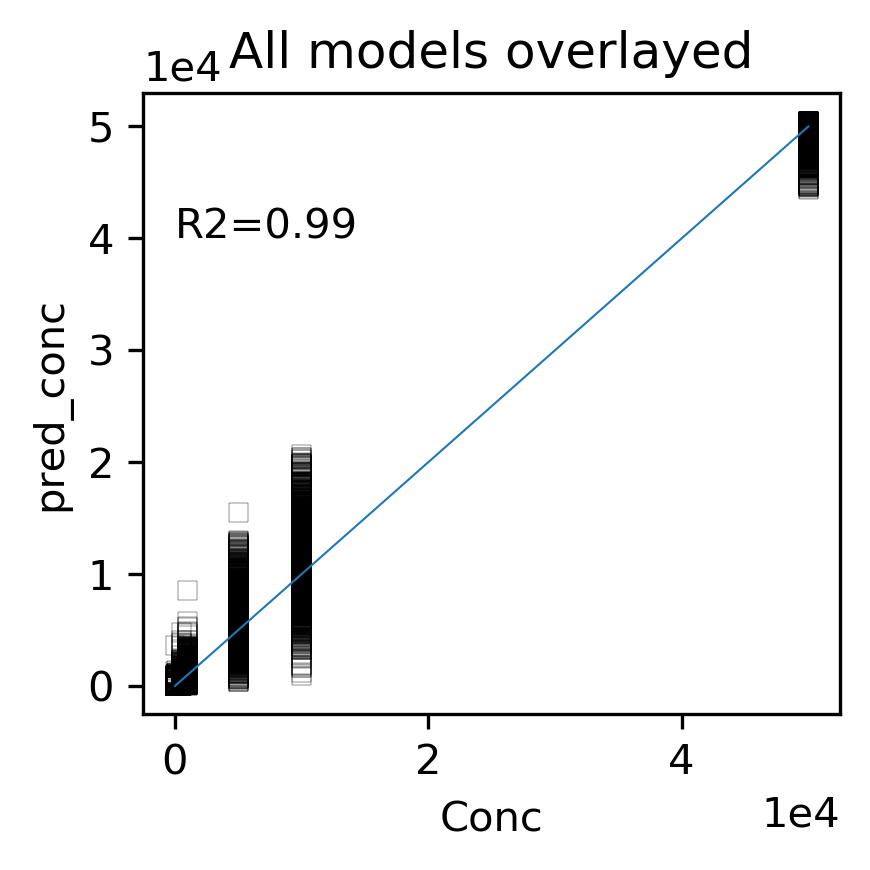

In [118]:
test_models(models_in_norm)

In [119]:
models_df = pd.DataFrame(models_in_norm, index=range(len(models_in_norm))).T[[0]].reset_index()
models_df

,level_0,level_1,level_2,level_3,0
0,0,SA005,neg,Acetoacetate,<function predict_conc at 0x7fec40806268>
1,0,SA005,neg,Acetyl-Threonine,<function predict_conc at 0x7fec40806c80>
2,0,SA005,neg,Adenine,<function predict_conc at 0x7fec408066a8>
3,0,SA005,neg,Adenosine,<function predict_conc at 0x7fec3bab10d0>
4,0,SA005,neg,Adenosine monophosphate,<function predict_conc at 0x7fec3b3cd268>
...,...,...,...,...,...
1488,1,SA002,pos,Thymine,<function predict_conc at 0x7fec1dd1cd08>
1489,1,SA002,pos,Uracil,<function predict_conc at 0x7fec1dd1cd90>
1490,1,SA002,pos,Uridine,<function predict_conc at 0x7fec1dd1ce18>
1491,1,SA002,pos,Valine,<function predict_conc at 0x7fec1dd1cea0>


In [120]:
models_df.level_1.value_counts()

SA008    111
SA010    110
SA016    109
SA012    109
SA001    109
SA014    109
SA005    109
SA015    108
SA006    107
SA007    107
SA009    104
SA011    103
SA002    101
SA013     97
Name: level_1, dtype: int64

In [121]:
len(models_in_norm)

1493

### Apply the model

In [122]:
import warnings
warnings.filterwarnings('ignore')

models = models_in_norm

metab_bi['pred_conc'] = np.NaN
metab_pool['pred_conc_pool_sa'] = np.NaN
metab_pool['pred_conc_pool_mh'] = np.NaN

for label in models.keys():
    pkar = metab_bi.loc[label, 'peak_area'].values
    pred_conc = np.array(models[label](pkar))
    metab_bi.loc[label, 'pred_conc'] = pred_conc

for label in models.keys():
    pkar = np.array([metab_pool.loc[label, 'POOL_SA']])
    pred_conc = np.array(models[label](pkar))
    metab_pool.loc[label, 'pred_conc_pool_sa'] = pred_conc

for label in models.keys():
    pkar = np.array([metab_pool.loc[label, 'POOL_MH']])
    pred_conc = np.array(models[label](pkar))
    metab_pool.loc[label, 'pred_conc_pool_mh'] = pred_conc

# Export metabolomics data

In [123]:
metab_bi_wl = pd.merge(worklists, metab_bi.reset_index(), on='ms_file', how='right').set_index(['RPT', 'PLATE', 'MS_MODE', 'peak_label'])
metab_bi_wl

ms_file  \
RPT PLATE MS_MODE peak_label                                                                  
0   SA008 pos     N-Acetyl-Phenylalanine  2020_04_20RG_HILICPos15S_Col001_LSARP_SA008_BI...   
                  Nicotinamide            2020_04_20RG_HILICPos15S_Col001_LSARP_SA008_BI...   
                  N-Acetyl-Glycine        2020_04_20RG_HILICPos15S_Col001_LSARP_SA008_BI...   
                  N-Acetyl-Methionine     2020_04_20RG_HILICPos15S_Col001_LSARP_SA008_BI...   
                  N-Acetyl-Leucine        2020_04_20RG_HILICPos15S_Col001_LSARP_SA008_BI...   
...                                                                                     ...   
1   SA002 neg     Nicotinate                                                            NaN   
                  Nicotinate                                                            NaN   
                  N-Acetyl-Phenylalanine                                                NaN   
                  N-Acetyl-Phenylalanine                                                NaN   
          pos     Xanthosine                                                            NaN   

                                         CHANNEL WELL_ROW  WELL_COL  \
RPT PLATE MS_MODE peak_label                                          
0   SA008 pos     N-Acetyl-Phenylalanine       G        A       2.0   
                  Nicotinamide                 G        A       2.0   
                  N-Acetyl-Glycine             G        A       2.0   
                  N-Acetyl-Methionine          G        A       2.0   
                  N-Acetyl-Leucine             G        A       2.0   
...                                          ...      ...       ...   
1   SA002 neg     Nicotinate                 NaN      NaN       NaN   
                  Nicotinate                 NaN      NaN       NaN   
                  N-Acetyl-Phenylalanine     NaN      NaN       NaN   
                  N-Acetyl-Phenylalanine     NaN      NaN       NaN   
          pos     Xanthosine                 NaN      NaN       NaN   

                                         ISOLATE_NBR       DATE      BI_NBR  \
RPT PLATE MS_MODE peak_label                                                  
0   SA008 pos     N-Acetyl-Phenylalanine  BI_16_2597 2020-04-20  BI_16_2597   
                  Nicotinamide            BI_16_2597 2020-04-20  BI_16_2597   
                  N-Acetyl-Glycine        BI_16_2597 2020-04-20  BI_16_2597   
                  N-Acetyl-Methionine     BI_16_2597 2020-04-20  BI_16_2597   
                  N-Acetyl-Leucine        BI_16_2597 2020-04-20  BI_16_2597   
...                                              ...        ...         ...   
1   SA002 neg     Nicotinate                      SA 2020-05-13         NaN   
                  Nicotinate                      MH 2020-05-13         NaN   
                  N-Acetyl-Phenylalanine          SA 2020-05-13         NaN   
                  N-Acetyl-Phenylalanine          MH 2020-05-13         NaN   
          pos     Xanthosine                      SA 2020-05-13         NaN   

                                           peak_area  BATCH   pred_conc  
RPT PLATE MS_MODE peak_label                                             
0   SA008 pos     N-Acetyl-Phenylalanine    24271.00      1    1.749714  
                  Nicotinamide             153657.00      1    0.770186  
                  N-Acetyl-Glycine          13437.00      1   29.156284  
                  N-Acetyl-Methionine      107883.00      1         NaN  
                  N-Acetyl-Leucine         195964.00      1   21.063202  
...                                              ...    ...         ...  
1   SA002 neg     Nicotinate                73896.00     14   42.143181  
                  Nicotinate               387384.00     14  220.926627  
                  N-Acetyl-Phenylalanine  1362315.75     14   82.121100  
                  N-Acetyl-Phenylalanine   481679.25     14   29.035875  
        

In [124]:
metab_full = pd.merge(metab_bi_wl.set_index('DATE', append=True), 
                      metab_pool.set_index('DATE', append=True), left_index=True, right_index=True)

metab_full = metab_full.sort_values('DATE')
ndx_names = metab_full.index.names

metab_full = metab_full.reset_index()
metab_full['DATE'] = metab_full['DATE'].astype(str)
metab_full = metab_full.set_index(ndx_names)

batch_id = (~metab_full.reset_index().PLATE.duplicated()).cumsum().values
metab_full['BATCH'] = batch_id
metab_full = metab_full.replace(0, np.NaN)

metab_full['peak_area_normed_sa'] = metab_full['peak_area'] / metab_full['POOL_SA']
metab_full['peak_area_normed_mh'] = metab_full['peak_area'] / metab_full['POOL_MH']

metab_full = metab_full.set_index(['ISOLATE_NBR', 'BI_NBR', 'BATCH'], append=True).rename(columns={'POOL_SA': 'peak_area_pool_sa',
                                                                                                   'POOL_MH': 'peak_area_pool_mh'})

metab_full = metab_full[['WELL_ROW', 'WELL_COL', 'ms_file', 'peak_area', 'peak_area_pool_sa', 'peak_area_pool_mh',  
                         'peak_area_normed_sa', 'peak_area_normed_mh',
                         'pred_conc',  'pred_conc_pool_sa', 'pred_conc_pool_mh', 
                         ]]
metab_full = metab_full.sort_values(['BATCH', 'WELL_ROW', 'WELL_COL'])
export_file = f'output/{NAME}__metabolomics-table.csv'
metab_full.to_csv(export_file)
export_file

'output/200611-sw__metabolomics_noTh_predict_conc_no-intercept__metabolomics-table.csv'

In [125]:
metab_full

WELL_ROW  \
RPT PLATE MS_MODE peak_label             DATE       ISOLATE_NBR BI_NBR     BATCH            
0   SA008 pos     Gamma-Amino butyrate   2020-04-20 BI_16_2597  BI_16_2597 1            A   
                  Folate                 2020-04-20 BI_16_2597  BI_16_2597 1            A   
                  Glutamine              2020-04-20 BI_16_2597  BI_16_2597 1            A   
                  Glutamate              2020-04-20 BI_16_2597  BI_16_2597 1            A   
                  Cystine                2020-04-20 BI_16_2597  BI_16_2597 1            A   
...                                                                                   ...   
1   SA002 neg     Nicotinate             2020-05-13 MH          NaN        14         NaN   
                                                    SA          NaN        14         NaN   
                  N-Acetyl-Phenylalanine 2020-05-13 MH          NaN        14         NaN   
                                                    SA          NaN        14         NaN   
          pos     Xanthosine             2020-05-13 SA          NaN        14         NaN   

                                                                                  WELL_COL  \
RPT PLATE MS_MODE peak_label             DATE       ISOLATE_NBR BI_NBR     BATCH             
0   SA008 pos     Gamma-Amino butyrate   2020-04-20 BI_16_2597  BI_16_2597 1           2.0   
                  Folate                 2020-04-20 BI_16_2597  BI_16_2597 1           2.0   
                  Glutamine              2020-04-20 BI_16_2597  BI_16_2597 1           2.0   
                  Glutamate              2020-04-20 BI_16_2597  BI_16_2597 1           2.0   
                  Cystine                2020-04-20 BI_16_2597  BI_16_2597 1           2.0   
...                                                                                    ...   
1   SA002 neg     Nicotinate             2020-05-13 MH          NaN        14          NaN   
                                                    SA          NaN        14          NaN   
                  N-Acetyl-Phenylalanine 2020-05-13 MH          NaN        14          NaN   
                                                    SA          NaN        14          NaN   
          pos     Xanthosine             2020-05-13 SA          NaN        14          NaN   

                                                                                                                            ms_file  \
RPT PLATE MS_MODE peak_label             DATE       ISOLATE_NBR BI_NBR     BATCH                                                      
0   SA008 pos     Gamma-Amino butyrate   2020-04-20 BI_16_2597  BI_16_2597 1      2020_04_20RG_HILICPos15S_Col001_LSARP_SA008_BI...   
                  Folate                 2020-04-20 BI_16_2597  BI_16_2597 1      2020_04_20RG_HILICPos15S_Col001_LSARP_SA008_BI...   
                  Glutamine              2020-04-20 BI_16_2597  BI_16_2597 1      2020_04_20RG_HILICPos15S_Col001_LSARP_SA008_BI...   
                  Glutamate              2020-04-20 BI_16_2597  BI_16_2597 1      2020_04_20RG_HILICPos15S_Col001_LSARP_SA008_BI...   
                  Cystine                2020-04-20 BI_16_2597  BI_16_2597 1      2020_04_20RG_HILICPos15S_Col001_LSARP_SA008_BI...   
...                                                                                                                             ...   
1   SA002 neg     Nicotinate             2020-05-13 MH          NaN        14                                                   NaN   
                                                    SA          NaN        14                                                   NaN   
                  N-Acetyl-Phenylalanine 2020-05-13 MH          NaN        14                                                   NaN   
                                                    SA          NaN        14                                                   NaN   
          pos     Xanthosine

# Analysis

In [155]:
nxd = (metab_bi_wl.reset_index().MS_MODE == 'pos').values

tmp = metab_bi_wl[metab_bi_wl.pred_conc.notnull() & nxd].reset_index()\
        .groupby(['BATCH', 'WELL_ROW', 'WELL_COL', 'ISOLATE_NBR', 'peak_label', 'MS_MODE'])\
        .pred_conc.mean().unstack(['peak_label', 'MS_MODE']).sort_index().apply(log1p)

tmp = ((tmp - tmp.mean()) / tmp.std())

figure(figsize=(100, 20))
sns.heatmap(tmp.T.sort_index(), cbar=False, cmap='hot', vmin=-3, vmax=3)
title('Predicted concentrations (Pos)', fontsize=50)
tight_layout()
savefig(f'output/{NAME}__scaled_log_pred_conc_heatmap_Pos.jpeg')

In [157]:
nxd = (metab_bi_wl.reset_index().MS_MODE == 'neg').values

tmp = metab_bi_wl[metab_bi_wl.pred_conc.notnull() & nxd].reset_index()\
        .groupby(['BATCH', 'WELL_ROW', 'WELL_COL', 'ISOLATE_NBR', 'peak_label', 'MS_MODE'])\
        .pred_conc.mean().unstack(['peak_label', 'MS_MODE']).sort_index().apply(log1p)

tmp = ((tmp - tmp.mean()) / tmp.std())

figure(figsize=(100, 20))
sns.heatmap(tmp.T.sort_index(), cbar=False, cmap='hot', vmin=-3, vmax=3)
title('Predicted concentrations (Neg)', fontsize=50)
tight_layout()
savefig(f'output/{NAME}__scaled_log_pred_conc_heatmap_Neg.jpeg')

peak_label                          Acetoacetate Acetyl-Threonine   Adenine  \
MS_MODE                                      neg              neg       neg   
BATCH WELL_ROW WELL_COL ISOLATE_NBR                                           
1     A        2.0      BI_16_2597      0.989338        -1.454914 -0.314199   
               3.0      BI_16_2606      0.994796        -1.287733 -0.607192   
               4.0      BI_16_2614      0.894165        -1.722159 -0.607192   
               5.0      BI_16_2615      1.132234        -1.599347 -0.607192   
               6.0      BI_16_2619      0.784401        -1.863070  0.395811   
...                                          ...              ...       ...   
14    H        6.0      BI_16_0709     -0.606651         0.104836 -0.607192   
               7.0      BI_16_0725     -0.668829         0.545030 -0.382848   
               8.0      BI_16_0730     -0.697939         0.728683 -0.607192   
               9.0      BI_16_0732     -0.186239         1.865154  0.184328   
               10.0     BI_16_0735     -0.724308         0.375698 -0.323875   

peak_label                          Adenosine Adenosine monophosphate  \
MS_MODE                                   neg                     neg   
BATCH WELL_ROW WELL_COL ISOLATE_NBR                                     
1     A        2.0      BI_16_2597  -0.353428               -0.293006   
               3.0      BI_16_2606   2.810698               -0.293006   
               4.0      BI_16_2614   2.622066                3.304790   
               5.0      BI_16_2615  -0.353428               -0.293006   
               6.0      BI_16_2619   3.176644               -0.293006   
...                                       ...                     ...   
14    H        6.0      BI_16_0709  -0.353428               -0.293006   
               7.0      BI_16_0725  -0.353428               -0.293006   
               8.0      BI_16_0730  -0.353428               -0.293006   
               9.0      BI_16_0732  -0.353428               -0.293006   
               10.0     BI_16_0735  -0.353428               -0.293006   

peak_label                          Alpha Ketoglutarate  Arabitol  Arginine  \
MS_MODE                                             neg       neg       neg   
BATCH WELL_ROW WELL_COL ISOLATE_NBR                                           
1     A        2.0      BI_16_2597            -1.333250 -0.203491  0.077027   
               3.0      BI_16_2606            -0.844103 -0.372932 -1.269444   
               4.0      BI_16_2614            -0.716706  0.525908 -0.848480   
               5.0      BI_16_2615            -1.438792  0.160080 -0.974493   
               6.0      BI_16_2619            -0.068557 -0.359824 -1.121263   
...                                                 ...       ...       ...   
14    H        6.0      BI_16_0709                  NaN  1.256480  1.730119   
               7.0      BI_16_0725                  NaN  1.596065  1.609537   
               8.0      BI_16_0730                  NaN  1.213541  1.884839   
               9.0      BI_16_0732                  NaN  2.048983  1.921554   
               10.0     BI_16_0735                  NaN  2.003547  1.833342   

peak_label                          Asparagine Aspartate  ... Thymidine  \
MS_MODE                                    neg       neg  ...       neg   
BATCH WELL_ROW WELL_COL ISOLATE_NBR                       ...             
1     A        2.0      BI_16_2597   -1.012128 -1.020831  ...  0.838594   
               3.0      BI_16_2606   -0.828056 -0.944107  ...  0.939627   
               4.0      BI_16_2614   -1.584178 -1.404085  ...  0.590326   
               5.0      BI_16_2615   -0.770461 -1.026116  ...  0.701740   
               6.0      BI_16_2619   -1.056425 -1.063464  ...  0.964257   
...                                        ...       ...  ...       ...   
14    H        6.0      BI_16_0709    0.459864 -0.032418  ...  0.023854   
             

In [128]:
metab_bi_with_conc = metab_bi_wl[(metab_bi_wl.pred_conc.notnull()) &
                                 (metab_bi_wl.ISOLATE_NBR.notnull())
                                 ]

metab_bi_with_conc

ms_file  \
RPT PLATE MS_MODE peak_label                                                                  
0   SA008 pos     N-Acetyl-Phenylalanine  2020_04_20RG_HILICPos15S_Col001_LSARP_SA008_BI...   
                  Nicotinamide            2020_04_20RG_HILICPos15S_Col001_LSARP_SA008_BI...   
                  N-Acetyl-Glycine        2020_04_20RG_HILICPos15S_Col001_LSARP_SA008_BI...   
                  N-Acetyl-Leucine        2020_04_20RG_HILICPos15S_Col001_LSARP_SA008_BI...   
                  Panthothenic acid       2020_04_20RG_HILICPos15S_Col001_LSARP_SA008_BI...   
...                                                                                     ...   
1   SA002 neg     N-Acetyl-Leucine                                                      NaN   
                  Nicotinate                                                            NaN   
                  Nicotinate                                                            NaN   
                  N-Acetyl-Phenylalanine                                                NaN   
                  N-Acetyl-Phenylalanine                                                NaN   

                                         CHANNEL WELL_ROW  WELL_COL  \
RPT PLATE MS_MODE peak_label                                          
0   SA008 pos     N-Acetyl-Phenylalanine       G        A       2.0   
                  Nicotinamide                 G        A       2.0   
                  N-Acetyl-Glycine             G        A       2.0   
                  N-Acetyl-Leucine             G        A       2.0   
                  Panthothenic acid            G        A       2.0   
...                                          ...      ...       ...   
1   SA002 neg     N-Acetyl-Leucine           NaN      NaN       NaN   
                  Nicotinate                 NaN      NaN       NaN   
                  Nicotinate                 NaN      NaN       NaN   
                  N-Acetyl-Phenylalanine     NaN      NaN       NaN   
                  N-Acetyl-Phenylalanine     NaN      NaN       NaN   

                                         ISOLATE_NBR       DATE      BI_NBR  \
RPT PLATE MS_MODE peak_label                                                  
0   SA008 pos     N-Acetyl-Phenylalanine  BI_16_2597 2020-04-20  BI_16_2597   
                  Nicotinamide            BI_16_2597 2020-04-20  BI_16_2597   
                  N-Acetyl-Glycine        BI_16_2597 2020-04-20  BI_16_2597   
                  N-Acetyl-Leucine        BI_16_2597 2020-04-20  BI_16_2597   
                  Panthothenic acid       BI_16_2597 2020-04-20  BI_16_2597   
...                                              ...        ...         ...   
1   SA002 neg     N-Acetyl-Leucine                SA 2020-05-13         NaN   
                  Nicotinate                      SA 2020-05-13         NaN   
                  Nicotinate                      MH 2020-05-13         NaN   
                  N-Acetyl-Phenylalanine          SA 2020-05-13         NaN   
                  N-Acetyl-Phenylalanine          MH 2020-05-13         NaN   

                                           peak_area  BATCH   pred_conc  
RPT PLATE MS_MODE peak_label                                             
0   SA008 pos     N-Acetyl-Phenylalanine    24271.00      1    1.749714  
                  Nicotinamide             153657.00      1    0.770186  
                  N-Acetyl-Glycine          13437.00      1   29.156284  
                  N-Acetyl-Leucine         195964.00      1   21.063202  
                  Panthothenic acid        853306.00      1    6.486299  
...                                              ...    ...         ...  
1   SA002 neg     N-Acetyl-Leucine        6435571.00     14  343.268029  
                  Nicotinate                73896.00     14   42.143181  
                  Nicotinate               387384.00     14  220.926627  
                  N-Acetyl-Phenylalanine  1362315.75     14   82.121100  
        

## Concentration over time bar-plots

In [129]:
pred_conc = metab_bi_with_conc.set_index(['ISOLATE_NBR', 'DATE', 'BATCH', 'WELL_ROW', 'WELL_COL'],append=True)['pred_conc']
pred_conc = pred_conc[~pred_conc.index.duplicated()]
pred_conc = pred_conc.unstack(['peak_label', 'MS_MODE'])

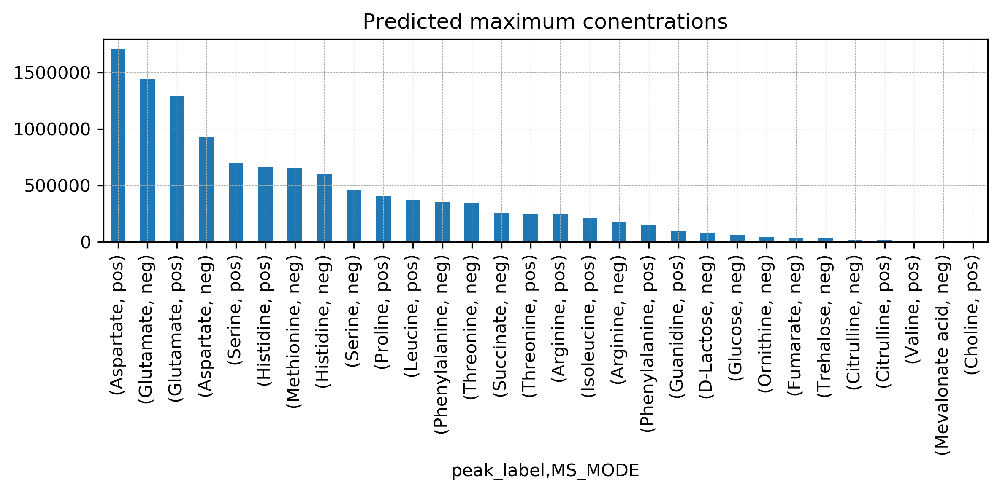

In [130]:
figure(figsize=(8,4), dpi=300)
pred_conc.max().sort_values(ascending=False).head(30).plot.bar()
title('Predicted maximum conentrations')
grid()
tight_layout()
savefig(f'output/{NAME}__predicted-max-conc.jpeg')

In [131]:
pred_conc = pred_conc.sort_index(level=(3,5,6))
pred_conc

peak_label                                               N-Acetyl-Phenylalanine  \
MS_MODE                                                                     pos   
RPT PLATE ISOLATE_NBR DATE       BATCH WELL_ROW WELL_COL                          
0   SA008 MH          2020-04-20 1     NaN      NaN                    1.686455   
          SA          2020-04-20 1     NaN      NaN                    5.482807   
          BI_16_2597  2020-04-20 1     A        2.0                    1.749714   
          BI_16_2606  2020-04-20 1     A        3.0                    6.696004   
          BI_16_2614  2020-04-20 1     A        4.0                    2.889181   
...                                                                         ...   
1   SA002 BI_16_0709  2020-05-13 14    H        6.0                   10.342651   
          BI_16_0725  2020-05-13 14    H        7.0                    6.762031   
          BI_16_0730  2020-05-13 14    H        8.0                    3.906661   
          BI_16_0732  2020-05-13 14    H        9.0                    6.765964   
          BI_16_0735  2020-05-13 14    H        10.0                   8.424804   

peak_label                                               Nicotinamide  \
MS_MODE                                                           pos   
RPT PLATE ISOLATE_NBR DATE       BATCH WELL_ROW WELL_COL                
0   SA008 MH          2020-04-20 1     NaN      NaN         34.163771   
          SA          2020-04-20 1     NaN      NaN          1.109888   
          BI_16_2597  2020-04-20 1     A        2.0          0.770186   
          BI_16_2606  2020-04-20 1     A        3.0          1.097013   
          BI_16_2614  2020-04-20 1     A        4.0          0.559105   
...                                                               ...   
1   SA002 BI_16_0709  2020-05-13 14    H        6.0          0.394947   
          BI_16_0725  2020-05-13 14    H        7.0          0.815465   
          BI_16_0730  2020-05-13 14    H        8.0          0.617874   
          BI_16_0732  2020-05-13 14    H        9.0          1.067554   
          BI_16_0735  2020-05-13 14    H        10.0         2.686465   

peak_label                                               N-Acetyl-Glycine  \
MS_MODE                                                               pos   
RPT PLATE ISOLATE_NBR DATE       BATCH WELL_ROW WELL_COL                    
0   SA008 MH          2020-04-20 1     NaN      NaN              0.000000   
          SA          2020-04-20 1     NaN      NaN              5.732745   
          BI_16_2597  2020-04-20 1     A        2.0             29.156284   
          BI_16_2606  2020-04-20 1     A        3.0              0.000000   
          BI_16_2614  2020-04-20 1     A        4.0              0.000000   
...                                                                   ...   
1   SA002 BI_16_0709  2020-05-13 14    H        6.0              0.000000   
          BI_16_0725  2020-05-13 14    H        7.0              0.000000   
          BI_16_0730  2020-05-13 14    H        8.0              0.000000   
          BI_16_0732  2020-05-13 14    H        9.0             15.466244   
          BI_16_0735  2020-05-13 14    H        10.0            17.291294   

peak_label                                               N-Acetyl-Leucine  \
MS_MODE                                                               pos   
RPT PLATE ISOLATE_NBR DATE       BATCH WELL_ROW WELL_COL                    
0   SA008 MH          2020-04-20 1     NaN      NaN             10.541732   
          SA          2020-04-20 1     NaN      NaN             21.395277   
          BI_16_2597  2020-04-20 1     A        2.0             21.063202   
          BI_16_2606  2020-04-20 1     A        3.0             20.261471   
          BI_16_2614  2020-04-20 1     A        4.0             12.205251   
...                                                                   ...   
1   SA002 BI_16_0709  2020-05-13 14    H  

### For selected compounds

In [132]:
selected_conc = pred_conc.iloc[:, pred_conc.columns.get_level_values(0).isin(['Proline', 'Phenylalanine', 'Leucine', 'Glutamate', 
                                                              'Aspartate', 'N-Acetyl threonine'])]\
                         .stack().stack().to_frame().rename(columns={0: 'pred_conc'})\
                         .reset_index()

qc = (selected_conc.ISOLATE_NBR == 'SA')*1 + (selected_conc.ISOLATE_NBR == 'MH')*5

selected_conc['QC'] = 'C' + qc.astype(str)
selected_conc

selected_conc.QC.value_counts()

C0    8112
C5     104
C1     104
Name: QC, dtype: int64

In [133]:
selected_conc.peak_label.value_counts()

Aspartate        2240
Glutamate        2240
Phenylalanine    1600
Leucine          1120
Proline          1120
Name: peak_label, dtype: int64

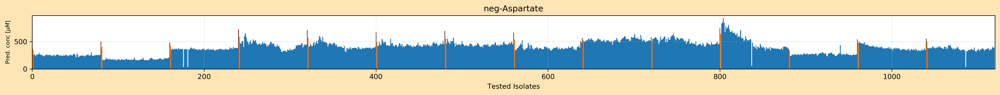

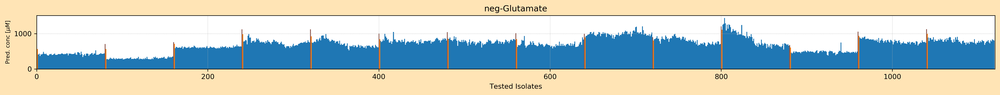

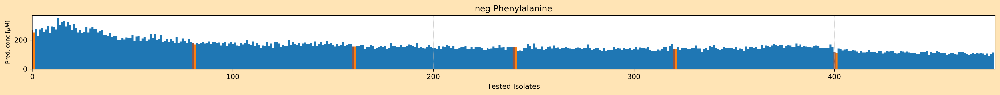

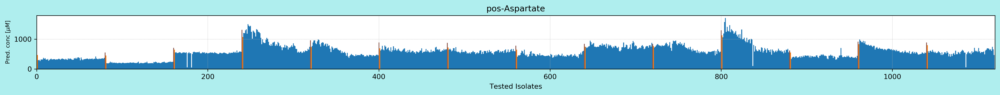

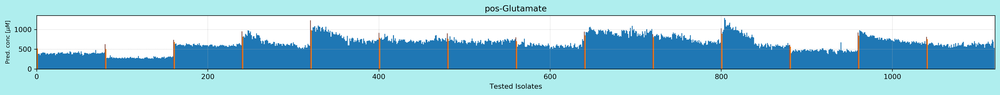

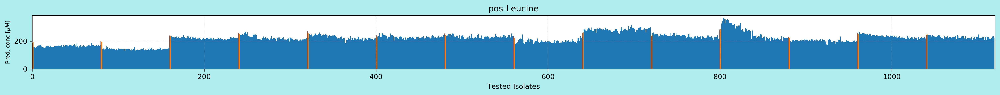

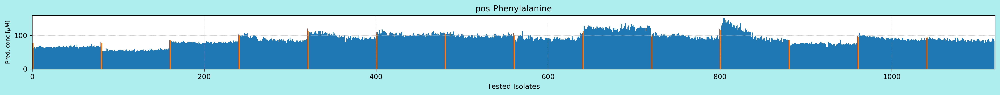

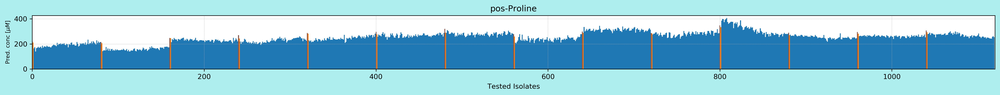

In [159]:
for label, grp in selected_conc.groupby(['MS_MODE', 'peak_label']):
    mode, compound = label
    if mode == 'pos':
        color = 'paleturquoise'
    if mode == 'neg':
        color = 'moccasin'
        
    figure(figsize=(20,2), facecolor=color)
        
    bar(range(len(grp)), grp.pred_conc / 1e3, color=grp.QC, width=1)
    xlim(0, len(grp))
    title('-'.join(label))
    ylabel('Pred. conc [$\mu M$]', fontsize=8)
    xlabel('Tested Isolates')
    grid()
    tight_layout()    
    savefig(f'output/{NAME}__bars-no-log-{label}.jpeg', facecolor=color)

## Residuals

In [135]:
metab_std

Conc                                            DATE           10  \
RPT PLATE MS_MODE peak_label                                        
0   SA005 neg     Acetoacetate            2020-05-06       5603.0   
                  Acetyl-Threonine        2020-05-06      78092.0   
                  Adenine                 2020-05-06     259516.0   
                  Adenosine               2020-05-06          NaN   
                  Adenosine monophosphate 2020-05-06          NaN   
...                                              ...          ...   
1   SA002 pos     Uridine                 2020-05-13          NaN   
                  Urocanate               2020-05-13    1063637.0   
                  Valine                  2020-05-13  156986318.0   
                  Xanthine                2020-05-13          NaN   
                  Xanthosine              2020-05-13      13716.0   

Conc                                                50          100  \
RPT PLATE MS_MODE peak_label                                          
0   SA005 neg     Acetoacetate                 25231.0      41924.0   
                  Acetyl-Threonine            565053.0    1238029.0   
                  Adenine                    1246488.0    2667637.0   
                  Adenosine                        NaN       6684.0   
                  Adenosine monophosphate          NaN          NaN   
...                                                ...          ...   
1   SA002 pos     Uridine                          NaN          NaN   
                  Urocanate                  6715284.0   14627334.0   
                  Valine                   189828669.0  211664884.0   
                  Xanthine                         NaN      20180.0   
                  Xanthosine                  210250.0     474485.0   

Conc                                               500         1000  \
RPT PLATE MS_MODE peak_label                                          
0   SA005 neg     Acetoacetate                213626.0     474736.0   
                  Acetyl-Threonine           6292911.0   12165759.0   
                  Adenine                   12579307.0   24268655.0   
                  Adenosine                    26173.0      95529.0   
                  Adenosine monophosphate          NaN       2207.0   
...                                                ...          ...   
1   SA002 pos     Uridine                          NaN       3843.0   
                  Urocanate                 71597066.0  122982488.0   
                  Valine                   421099334.0  652661676.0   
                  Xanthine                    315334.0     640807.0   
                  Xanthosine                 2802892.0    6521325.0   

Conc                                               5000         10000  \
RPT PLATE MS_MODE peak_label                                            
0   SA005 neg     Acetoacetate             2.609513e+06  4.621965e+06   
                  Acetyl-Threonine         6.551983e+07  1.294402e+08   
                  Adenine                  1.042605e+08  1.807610e+08   
                  Adenosine                6.545940e+05  1.145870e+06   
                  Adenosine monophosphate  3.451800e+04  9.127200e+04   
...                                                 ...           ...   
1   SA002 pos     Uridine                  1.899590e+05  3.871690e+05   
                  Urocanate                2.110481e+08  1.967483e+08   
                  Valine                   2.100415e+09  3.524160e+09   
                  Xanthine                 3.400007e+06  7.969587e+06   
                  Xanthosine               3.762684e+07  6.762569e+07   

Conc                                              50000  
RPT PLATE MS_MODE peak_label                             
0   SA005 neg     Acetoacetate             1.277792e+07  
                  Acetyl-Threonine         6.248939e+08  
                  Adenine                  5.811508e+08  
              

In [136]:
standards_peak_areas = metab_std.reset_index().melt(id_vars=['RPT', 'PLATE', 'MS_MODE', 'DATE', 'peak_label'], value_name='peak_area')
standards_peak_areas = standards_peak_areas.set_index(['RPT', 'PLATE', 'MS_MODE', 'peak_label'])
standards_peak_areas

DATE   Conc     peak_area
RPT PLATE MS_MODE peak_label                                             
0   SA005 neg     Acetoacetate            2020-05-06     10  5.603000e+03
                  Acetyl-Threonine        2020-05-06     10  7.809200e+04
                  Adenine                 2020-05-06     10  2.595160e+05
                  Adenosine               2020-05-06     10           NaN
                  Adenosine monophosphate 2020-05-06     10           NaN
...                                              ...    ...           ...
1   SA002 pos     Uridine                 2020-05-13  50000  2.617291e+06
                  Urocanate               2020-05-13  50000  1.402083e+08
                  Valine                  2020-05-13  50000  8.351341e+09
                  Xanthine                2020-05-13  50000  1.810034e+07
                  Xanthosine              2020-05-13  50000  1.260948e+08

[16240 rows x 3 columns]

In [137]:
# apply models
for label in models.keys():
    pkar = standards_peak_areas.fillna(0).loc[label, 'peak_area'].values
    pred_conc = np.array(models[label](pkar))
    standards_peak_areas.loc[label, 'pred_conc'] = pred_conc

In [138]:
standards_peak_areas = standards_peak_areas.dropna()

In [139]:
standards_peak_areas['residuals'] = standards_peak_areas.pred_conc - standards_peak_areas.Conc

In [140]:
standards_peak_areas = standards_peak_areas.reset_index()

In [141]:
standards_peak_areas = standards_peak_areas.sort_values('PLATE')
standards_peak_areas

,RPT,PLATE,MS_MODE,peak_label,DATE,Conc,peak_area,pred_conc,residuals
7294,1,SA001,neg,N-Acetyl-Methionine,2020-05-11,5000,114249420.0,4946.118047,-53.882
5822,1,SA001,neg,Orotate,2020-05-11,1000,422532.0,875.938819,-124.061
5823,1,SA001,neg,Panthothenic acid,2020-05-11,1000,22997215.0,1416.999592,417
5824,1,SA001,neg,Phenylalanine,2020-05-11,1000,164236.0,8504.415779,7504.42
5825,1,SA001,neg,Rhamnose,2020-05-11,1000,219200.0,1832.003390,832.003
...,...,...,...,...,...,...,...,...,...
4362,0,SA016,pos,Creatinine,2020-05-04,500,195132507.0,1681.734424,1181.73
4363,0,SA016,pos,Cytidine,2020-05-04,500,1278717.0,386.954600,-113.045
4364,0,SA016,pos,Cytosine,2020-05-04,500,27369218.0,928.941605,428.942
4338,0,SA016,neg,Nicotinate,2020-05-04,500,1195905.0,702.382750,202.383


In [142]:
standards_peak_areas['Residuals [$\mu M$]'] = standards_peak_areas.residuals / 1e3
standards_peak_areas

,RPT,PLATE,MS_MODE,peak_label,DATE,Conc,peak_area,pred_conc,residuals,Residuals [$\mu M$]
7294,1,SA001,neg,N-Acetyl-Methionine,2020-05-11,5000,114249420.0,4946.118047,-53.882,-0.053882
5822,1,SA001,neg,Orotate,2020-05-11,1000,422532.0,875.938819,-124.061,-0.124061
5823,1,SA001,neg,Panthothenic acid,2020-05-11,1000,22997215.0,1416.999592,417,0.417
5824,1,SA001,neg,Phenylalanine,2020-05-11,1000,164236.0,8504.415779,7504.42,7.50442
5825,1,SA001,neg,Rhamnose,2020-05-11,1000,219200.0,1832.003390,832.003,0.832003
...,...,...,...,...,...,...,...,...,...,...
4362,0,SA016,pos,Creatinine,2020-05-04,500,195132507.0,1681.734424,1181.73,1.18173
4363,0,SA016,pos,Cytidine,2020-05-04,500,1278717.0,386.954600,-113.045,-0.113045
4364,0,SA016,pos,Cytosine,2020-05-04,500,27369218.0,928.941605,428.942,0.428942
4338,0,SA016,neg,Nicotinate,2020-05-04,500,1195905.0,702.382750,202.383,0.202383


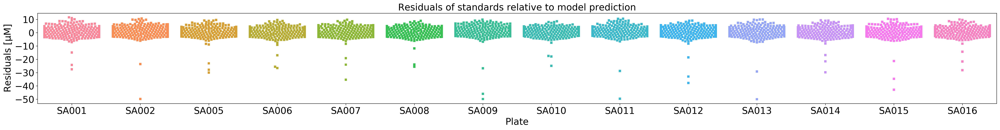

In [95]:
figure(figsize=(30,4))
sns.swarmplot(data=standards_peak_areas, x='PLATE', y='Residuals [$\mu M$]')
title('Residuals of standards relative to model prediction', fontsize=20)
xticks(fontsize=20)
ylabel('Residuals [$\mathrm{\mu M}$]', fontsize=20)
xlabel('Plate', fontsize=20)
yticks(fontsize=20)
grid()
savefig(f'output/{NAME}__residuals_swarmplot.jpeg')

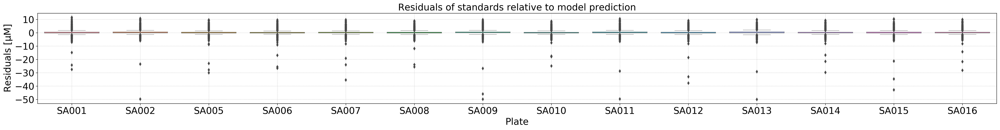

In [143]:
figure(figsize=(30,4))
sns.boxplot(data=standards_peak_areas, x='PLATE', y='Residuals [$\mu M$]')
title('Residuals of standards relative to model prediction', fontsize=20)
xticks(fontsize=20)
ylabel('Residuals [$\mathrm{\mu M}$]', fontsize=20)
xlabel('Plate', fontsize=20)
yticks(fontsize=20)
grid()
savefig(f'output/{NAME}__residuals_boxplot.jpeg')

### PCA

In [35]:
from matplotlib import pyplot as plt
from scipy.cluster.hierarchy import linkage, dendrogram
from scipy.spatial.distance import pdist, squareform

def hierachical_clustering(df, plot=True, vmin=None, vmax=None,
                           metric='euclidean', top_pc=0.8, left_pc=0.8
                           figsize=(8,8)):
    '''based on heatmap function from
    http://nbviewer.ipython.org/github/herrfz/dataanalysis/
    blob/master/week3/svd_pca.ipynb
    Generates a heatmap from the input matrix.
    '''
    
    no_plot = not plot
    
    D1 = squareform(pdist(df, metric=metric))
    D2 = squareform(pdist(df.T, metric=metric))
    
    if plot:
        f = plt.figure(figsize=figsize, dpi=600)
        # add side dendrogram
        ax1 = f.add_axes([0.601, 0.1, 0.2, top_pc-0.001], frameon=False)
        
    Y = linkage(D1, method='complete')
    Z1 = dendrogram(Y, orientation='right', no_plot=no_plot)
    
    if plot:
        ax1.set_xticks([])
        ax1.set_yticks([])
        # add top dendrogram
        ax2 = f.add_axes([0.0, top_pc+0.1, 0.6, 1-top_pc], frameon=False)
        
    Y = linkage(D2, method='complete')
    Z2 = dendrogram(Y, no_plot=no_plot)
    if plot:
        ax2.set_xticks([])
        ax2.set_yticks([])
        # add matrix plot
        axmatrix = f.add_axes([0.0, 0.1, 0.6, top_pc-0.001])
        
    idx1 = Z1['leaves']
    idx2 = Z2['leaves']
    D = df.iloc[idx1, idx2]
    if plot:
        sns.heatmap(D[::-1].replace(0, np.NaN), cbar=False, vmin=vmin, vmax=vmax, cmap='hot')
    return {'ordered': D, 'rorder': Z1['leaves'], 'corder': Z2['leaves']}

In [36]:
plt.rcParams['figure.constrained_layout.use'] = True

## Cluster analysis

In [37]:
from sklearn.preprocessing import MinMaxScaler
pred_conc_scaled = pred_conc.copy()
pred_conc_scaled.loc[:,:] = MinMaxScaler().fit_transform(pred_conc)

In [38]:
out = hierachical_clustering(pred_conc_scaled.fillna(0).T, vmin=None, vmax=None, top_pc=0.95, figsize=(60, 20))
savefig(f'output/{NAME}__clustering_plates.jpeg',  bbox_inches='tight', pad_inches=0.0)